## Notebook for the mapping of cardiac immune populations ofn 10X LV Visium dataset

- Carlos Talavera-López Ph.D - WSI
- v200720

### Import required modules

In [1]:
import numpy as np
import scipy as sp
import scanpy as sc
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt
from matplotlib import rcParams
import matplotlib.image as mpimg

import SpatialDE

plt.rcParams['figure.figsize'] = (12,12)

%load_ext autoreload
%autoreload 2

/opt/conda/lib/python3.7/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex
/opt/conda/lib/python3.7/site-packages/dask/config.py:161: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}


In [2]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 180, frameon = False, color_map = 'RdPu')

scanpy==1.4.6 anndata==0.7.1 umap==0.3.10 numpy==1.18.1 scipy==1.2.1 pandas==1.0.5 scikit-learn==0.22.2 statsmodels==0.11.1 python-igraph==0.8.0 louvain==0.6.1


### Read in Visium dataset

In [3]:
LV_visium = sc.read_visium(path = '/home/jovyan/data/10x_st/heart_ST/', count_file = 'V1_Human_Heart_filtered_feature_bc_matrix.h5', load_images = True)
LV_visium.var_names_make_unique()
LV_visium

reading /home/jovyan/data/10x_st/heart_ST/V1_Human_Heart_filtered_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:00)


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


AnnData object with n_obs × n_vars = 4235 × 33538 
    obs: 'in_tissue', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'images', 'scalefactors'
    obsm: 'X_spatial'

In [4]:
sc.pp.calculate_qc_metrics(LV_visium, inplace = True)
LV_visium.var['MT'] = [gene.startswith('MT-') for gene in LV_visium.var_names]
LV_visium.obs['percent_mito'] = LV_visium[:, LV_visium.var['MT']].X.sum(1).A.squeeze()/LV_visium.obs['total_counts']
LV_visium.obs['percent_mito'].mean()

0.39143947

### QC and preprocessing 

/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:200: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


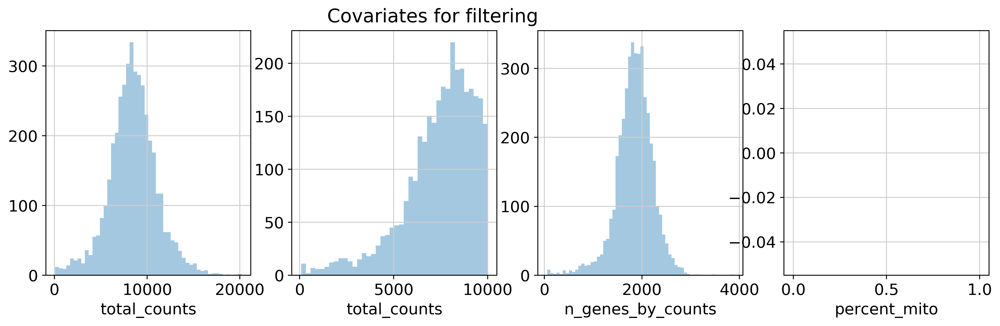

In [5]:
fig, axs = plt.subplots(1,4, figsize = (15, 4))

fig.suptitle('Covariates for filtering')
sb.distplot(LV_visium.obs['total_counts'], kde = False, ax = axs[0])
sb.distplot(LV_visium.obs['total_counts'][LV_visium.obs['total_counts'] < 10000], kde = False, bins = 40, ax = axs[1])
sb.distplot(LV_visium.obs['n_genes_by_counts'], kde = False, bins = 60, ax = axs[2])
sb.distplot(LV_visium.obs['percent_mito'][LV_visium.obs['percent_mito']], kde = False, bins = 60, ax = axs[3])

In [6]:
sc.pp.filter_cells(LV_visium, min_counts = 500)
print(f'Number of cells after min count filter: {LV_visium.n_obs}')
sc.pp.filter_cells(LV_visium, max_counts = 20000)
print(f'Number of cells after max count filter: {LV_visium.n_obs}')
sc.pp.filter_cells(LV_visium, min_genes = 200)
print(f'Number of cells after gene filter: {LV_visium.n_obs}')

filtered out 13 cells that have less than 500 counts
Number of cells after min count filter: 4222
filtered out 1 cells that have more than 20000 counts
Number of cells after max count filter: 4221
Number of cells after gene filter: 4221


In [7]:
LV_visium

AnnData object with n_obs × n_vars = 4221 × 33538 
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'MT'
    uns: 'images', 'scalefactors'
    obsm: 'X_spatial'

### Normalise and transform data

In [8]:
sc.pp.normalize_total(LV_visium, inplace = True)
sc.pp.log1p(LV_visium)
sc.pp.highly_variable_genes(LV_visium, flavor = 'seurat', inplace = True)

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


### Visualise data on `Visium` HiRes image

... storing 'feature_types' as categorical
... storing 'genome' as categorical


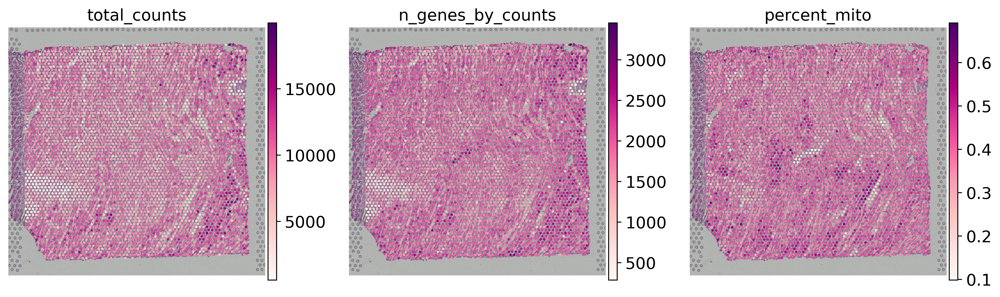

In [9]:
sc.pl.spatial(LV_visium, img_key = "hires", color = ['total_counts', 'n_genes_by_counts', 'percent_mito'])

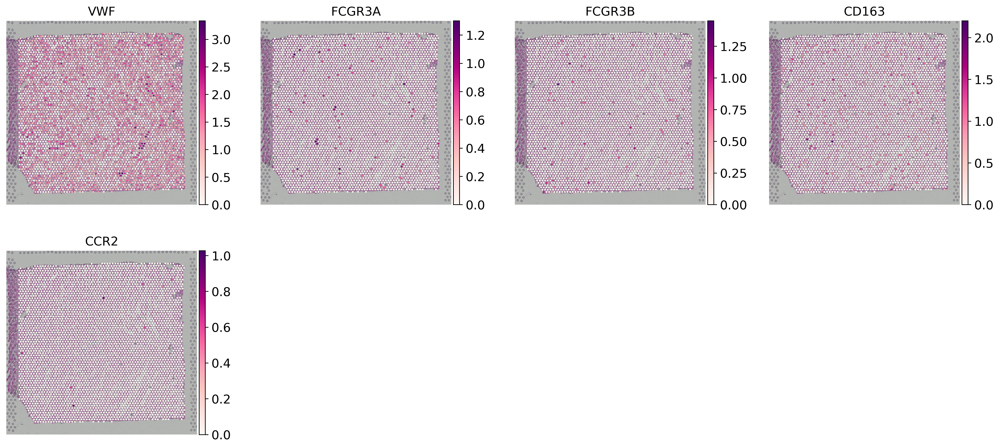

In [11]:
sc.settings.set_figure_params(dpi = 180, frameon = False, color_map = 'RdPu')
sc.pl.spatial(LV_visium, img_key = "hires", color = ["VWF","FCGR3A","FCGR3B","CD163","CCR2"], size = 1)

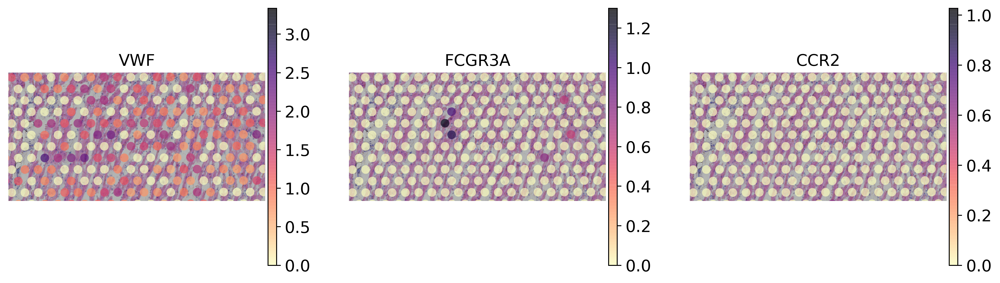

In [24]:
sc.pl.spatial(LV_visium, img_key = "hires", color = ["VWF","FCGR3A","CCR2"], crop_coord = [600,1000,800,600], alpha = 0.7, size = 1, color_map = 'magma_r', ncols = 3)

### Global markers

In [ ]:
sc.settings.set_figure_params(dpi = 80, frameon = False, color_map = 'RdPu')
sc.pl.spatial(LV_visium, img_key = "hires", color = ['MYH7','MYL2','PRDM16','NPPA','MYH7','MYL4','VWF','PECAM1','CDH5','RGS5','ABCC9','KCNJ8','MYH11','TAGLN','ACTA2','DCN','GSN','PDGFRA','CD14','C1QA','FOLR2','CD8A','NKG7','LCK','PLP1','NRXN1','NRXN3','GPAM'], size = 1)

In [ ]:
sc.pl.spatial(LV_visium, img_key = "hires", color = ["CDH5", "MYH11", "ACKR1", "SEMA3G"], size = 1, alpha_img = 0.6)

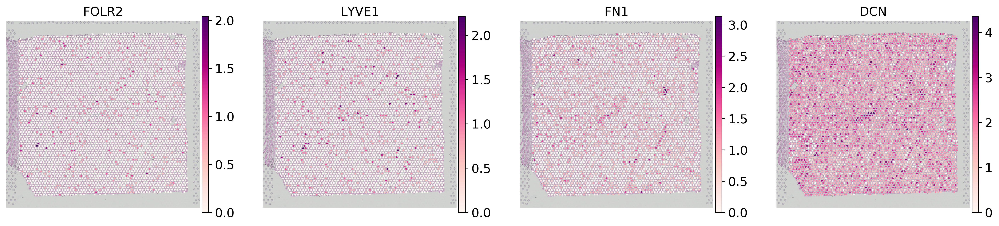

In [42]:
sc.pl.spatial(LV_visium, img_key = "hires", color = ["FOLR2", "LYVE1", "FN1", "DCN"], size = 1, alpha_img = 0.6)

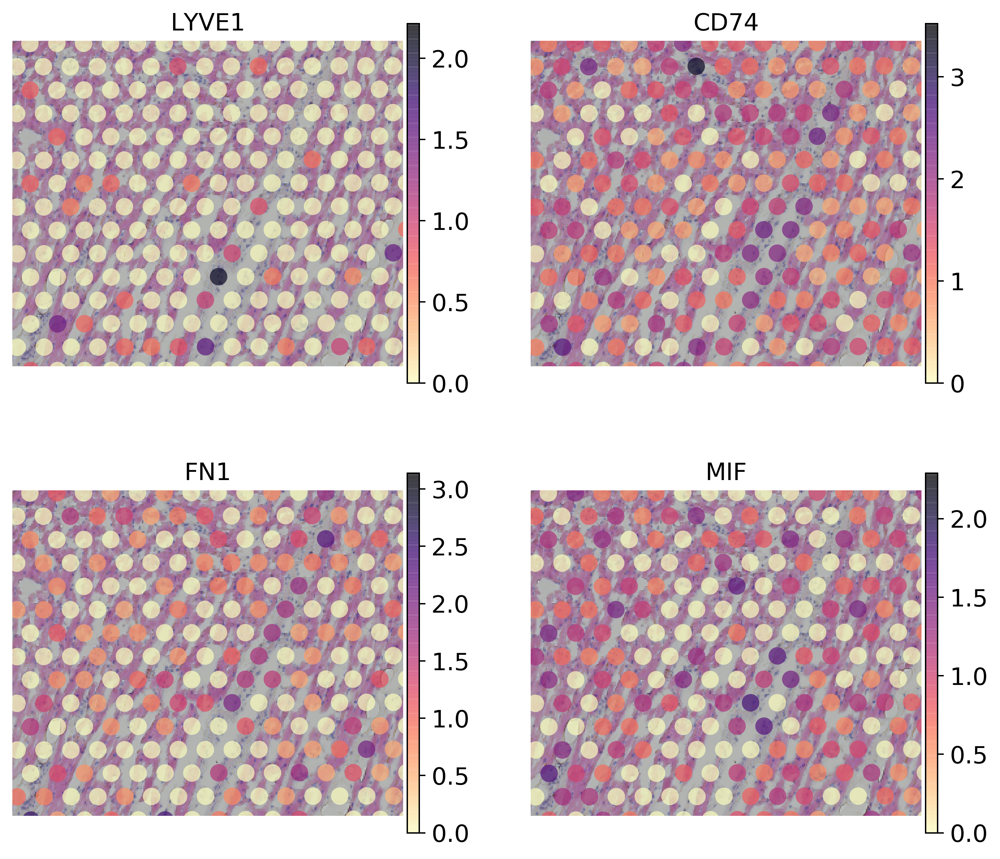

In [53]:
sc.pl.spatial(LV_visium, img_key = "hires", color = ["LYVE1","CD74","FN1","MIF"], crop_coord = [1200,1500,850,600], alpha = 0.7, size = 1, color_map = 'magma_r', ncols = 2, save = '_HCA_Heart_Immune_CD74_MIF_interaction_ctl2000606.svg')

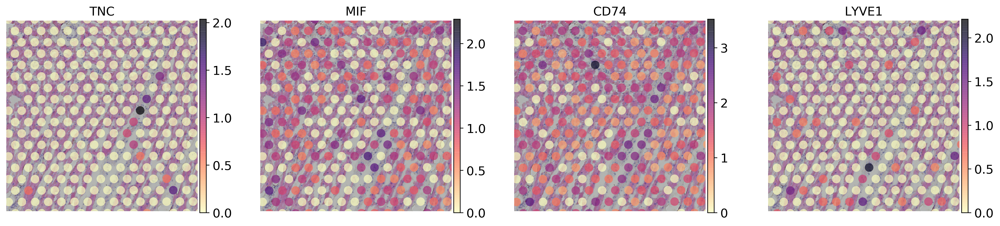

In [36]:
sc.pl.spatial(LV_visium, img_key = "hires", color = ["TNC","MIF","CD74","LYVE1"], crop_coord = [1200,1500,900,600], alpha = .7, size = 1, color_map = 'magma_r')

In [ ]:
sc.pl.spatial(LV_visium, img_key = "hires", color = ["FOLR2", "LYVE1","AREG", "EGFR"], crop_coord = [1200,1700,900,650], alpha = .7, size = 1, color_map = 'magma_r')

In [ ]:
sc.pl.spatial(LV_visium, img_key = "hires", color = ['C1orf54', 'CADM1', 'CAMK2D', 'IDO1'], size = 1, alpha_img = 0.6)

In [ ]:
sc.pl.spatial(LV_visium, img_key = "hires", color = ['C1orf54', 'CADM1', 'CAMK2D', 'IDO1'], crop_coord = [200,700,900,650], alpha = .7, size = 1, color_map = 'magma_r')

### Zoom in a specific region

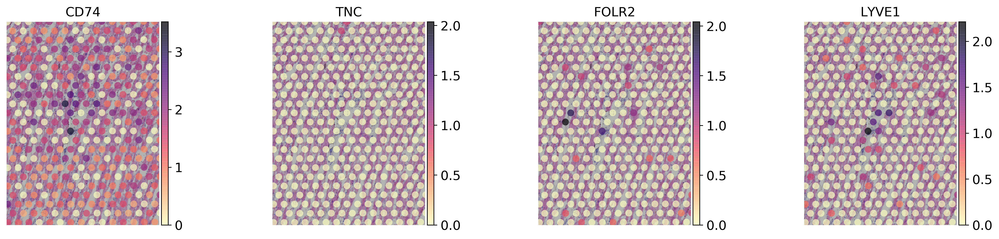

In [15]:
sc.pl.spatial(LV_visium, img_key = "hires", color = ["CD74", "TNC", "FOLR2", "LYVE1"], crop_coord = [500,800,900,500], alpha = 0.7, size = 1, color_map = 'magma_r')

In [ ]:
sc.pl.spatial(LV_visium, img_key = "hires", color = ["CD74", "JUNB", "ATF3", "KLF2", "MAF"], crop_coord = [300,700,900,500], alpha = .7, size = 1, color_map = 'magma_r')

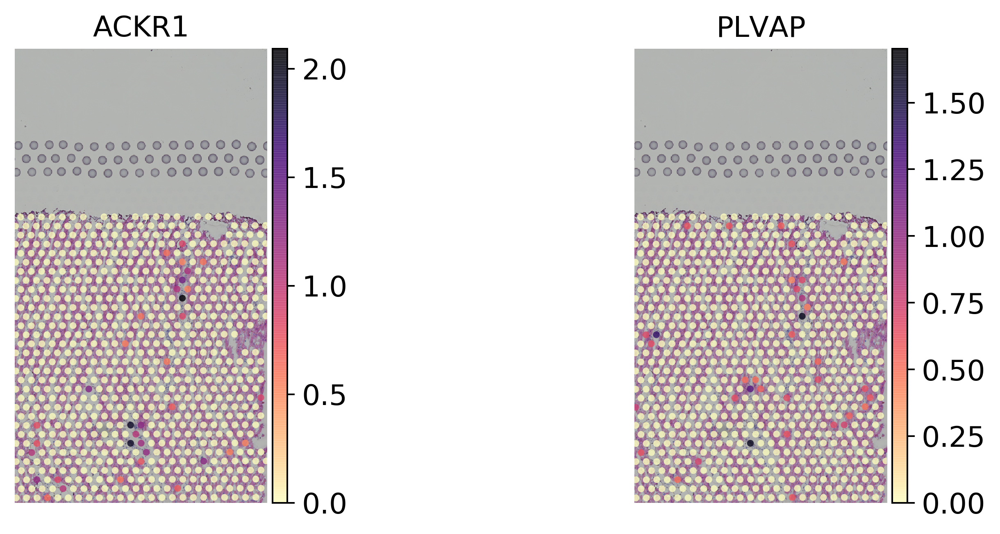

In [18]:
sc.pl.spatial(LV_visium, img_key = "hires", color = ['ACKR1', 'PLVAP'], crop_coord = [1200,1700,1900,1000], alpha = .8, size = 1, color_map = 'magma_r')

### Export `10X Visium` object

In [ ]:
LV_visium.write('/home/jovyan/data/10x_st/heart_ST/Heart_LV_10X_Visium_ctl200427_QCed_RAW.h5ad')

In [ ]:
sc.pl.spatial(LV_visium, img_key = "hires", color = ['NOTCH3', 'DLL1'], crop_coord = [1200,1800,1700,1200], alpha = 0.7, size = 1, color_map = 'magma_r')

In [ ]:
sc.pl.spatial(LV_visium, img_key = "hires", color = ['NOTCH2', 'JAG1'], crop_coord = [700,1400,1100,800], alpha = 0.7, size = 1, color_map = 'magma_r')

### Map regulons

In [ ]:
sc.pl.spatial(LV_visium, img_key = "hires", color = ["LYVE1","C1QA"], crop_coord = [1200,1600,850,550], alpha = .7, size = 1, color_map = 'magma_r')